In [348]:
import torch
import torch.nn as nn
import pandas as pd
import numpy as np
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from torch import autograd
from torch.autograd import Variable
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
from skimage import io, transform, color
import os
import json
from PIL import Image

In [349]:
#def image_to_vector(image: numpy.ndarray) -> numpy.ndarray:

#    length, height, depth = image.shape
#    return image.reshape((length * height * depth, 1))
class browndataset(Dataset):
    def __init__(self, json_path, root_dir, img_transform=None,label_transform = None):
        """
        Args:
            csv_file (string): Path to the csv file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.data = json.load(open(json_path))
        self.root_dir = root_dir
        self.img_transform = img_transform
        self.label_transform = label_transform

    def __len__(self):
        return len((self.data)["id"])

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        img_name = os.path.join(self.root_dir,
                                self.data["id"][idx])
        immm =io.imread(img_name)
        #imre = transform.resize(immm, (128,128), anti_aliasing=True)
        
        #imm2 = imre.astype(np.uint8).reshape((-1, 128, 128))
        PIL_image = Image.fromarray(immm)
        #lina_gray = color.rgb2gray(immm)
        
        
        cl = self.data['classes'][idx]
        classes = np.array(cl)
        
        
        #sample = {'image': image, 'classes': cl}

        if self.img_transform:
            t_image = self.img_transform(PIL_image)
        if self.label_transform:
            classes = self.label_transform(classes)
        
        return t_image, classes
#img_size = 224
img_transform = transforms.Compose([
    transforms.Grayscale(num_output_channels=1),
            transforms.ToTensor(),
    transforms.Resize((128,128)),
    transforms.Normalize(mean=(0.5,), std=(0.5,))
            ])
label_transform = transforms.Compose([transforms.ToTensor()])

In [350]:
dbrown = browndataset(json_path = './label_images_of_brown.json', root_dir='./datasets/brown/test',img_transform = img_transform)

In [351]:
dbrown[0][0].shape

torch.Size([1, 128, 128])

In [352]:
data_loader = DataLoader(dbrown, batch_size=5, shuffle=True, num_workers=4)

In [353]:
for i, (images, labels) in enumerate(data_loader):
    print(i)
    break

0


(199, 220, 3)
(128, 128, 3)
(199, 220)
(1, 128, 128)
(3, 128, 128)


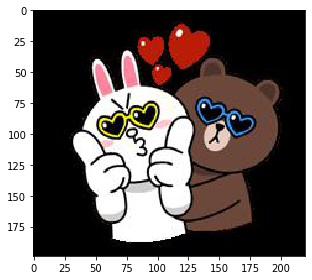

In [354]:
immm = io.imread('./datasets/brown/test/555.png')
imre = transform.resize(immm, (128,128), anti_aliasing=True)
lina_gray= color.rgb2gray(io.imread('./datasets/brown/test/555.png'))
print(immm.shape)
print(imre.shape)
print(lina_gray.shape)
lina_gray2
print(lina_gray2.shape)
print(imm2.shape)
io.imshow(immm)



In [356]:
dbrown[1][1]

array([0, 0, 0, 1, 0, 0, 0, 0, 0])

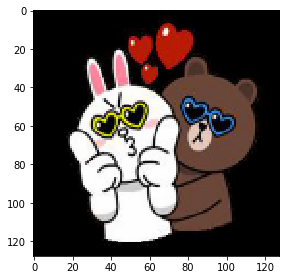

In [357]:
io.imshow(imre)

In [358]:
for i, (images, labels) in enumerate(data_loader):
    print(i)
    break

0


In [359]:
import os
#os.listdir('./datasets/brown/test')

## Continue here

In [360]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        
        self.label_emb = nn.Embedding(10,9)
        
        self.model = nn.Sequential(
            nn.Linear(16384+81, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.3),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )
    
    def forward(self, x, labels):
        x = x.view(x.size(0), 16384)
        c = self.label_emb(labels)
        x = torch.cat([x, c.view(x.size(0),-1)], 1)
        #print(x.shape, labels.shape)
        out = self.model(x)
        return out.squeeze()

In [361]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        
        self.label_emb = nn.Embedding(10, 9)
        
        self.model = nn.Sequential(
            nn.Linear(181, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 128*128),
            nn.Tanh()
        )
    
    def forward(self, z, labels):
        z = z.view(z.size(0), 100)
        c = self.label_emb(labels)
        x = torch.cat([z, c.view(z.size(0), -1)], 1)
        #print(x.shape, labels.shape)
        out = self.model(x)
        return out.view(x.size(0), 128, 128)

In [362]:
generator = Generator().cuda()
discriminator = Discriminator().cuda()
print(generator)
print(discriminator)

Generator(
  (label_emb): Embedding(10, 9)
  (model): Sequential(
    (0): Linear(in_features=181, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Linear(in_features=256, out_features=512, bias=True)
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Linear(in_features=512, out_features=1024, bias=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Linear(in_features=1024, out_features=16384, bias=True)
    (7): Tanh()
  )
)
Discriminator(
  (label_emb): Embedding(10, 9)
  (model): Sequential(
    (0): Linear(in_features=16465, out_features=1024, bias=True)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Dropout(p=0.3, inplace=False)
    (3): Linear(in_features=1024, out_features=512, bias=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Dropout(p=0.3, inplace=False)
    (6): Linear(in_features=512, out_features=256, bias=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    

In [363]:
criterion = nn.BCELoss()
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=1e-4)
g_optimizer = torch.optim.Adam(generator.parameters(), lr=1e-4)

In [364]:
target = torch.randint(0, 9, (5,))
one_hot = torch.nn.functional.one_hot( torch.randint(0, 9, (5,)),num_classes=9)
print(one_hot)

tensor([[0, 1, 0, 0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0, 0, 1, 0],
        [0, 0, 0, 0, 0, 1, 0, 0, 0],
        [1, 0, 0, 0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0, 0, 1, 0]])


In [365]:
torch.zeros(5,9).long()[0,2]=1

In [366]:
def generator_train_step(batch_size, discriminator, generator, g_optimizer, criterion):
    g_optimizer.zero_grad()
    z = Variable(torch.randn(batch_size, 100)).cuda()
    fake_labels = torch.nn.functional.one_hot( torch.randint(0, 9, (batch_size,)),num_classes=9).cuda()
    fake_images = generator(z, fake_labels)
    validity = discriminator(fake_images, fake_labels)
    g_loss = criterion(validity, Variable(torch.ones(batch_size)).cuda())
    g_loss.backward()
    g_optimizer.step()
    return g_loss.item()

In [367]:
def discriminator_train_step(batch_size, discriminator, generator, d_optimizer, criterion, real_images, labels):
    d_optimizer.zero_grad()

    # train with real images
    real_validity = discriminator(real_images, labels)
    real_loss = criterion(real_validity, Variable(torch.ones(batch_size)).cuda())
    
    # train with fake images
    z = Variable(torch.randn(batch_size, 100)).cuda()
    fake_labels = torch.nn.functional.one_hot( torch.randint(0, 9, (batch_size,)),num_classes=9).cuda()
    #print('fake_labels', fake_labels.shape)
    fake_images = generator(z, fake_labels)
    fake_validity = discriminator(fake_images, fake_labels)
    fake_loss = criterion(fake_validity, Variable(torch.zeros(batch_size)).cuda())
    
    d_loss = real_loss + fake_loss
    d_loss.backward()
    d_optimizer.step()
    return d_loss.item()

In [368]:
torch.randint(0, 9, (9,))

tensor([0, 3, 0, 7, 2, 0, 2, 0, 3])

Starting epoch 0...
g_loss: 1.526214361190796, d_loss: 0.8875823020935059


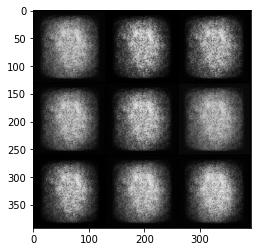

Starting epoch 1...
g_loss: 3.045330286026001, d_loss: 0.0920940488576889


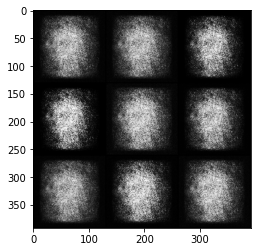

Starting epoch 2...
g_loss: 1.1538176536560059, d_loss: 0.7151057720184326


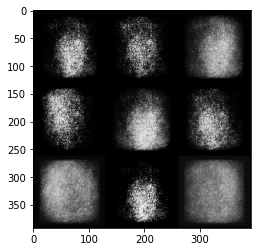

Starting epoch 3...
g_loss: 1.8784751892089844, d_loss: 0.7888063192367554


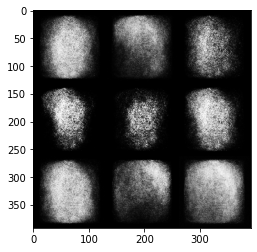

Starting epoch 4...
g_loss: 0.8947666883468628, d_loss: 0.4023014008998871


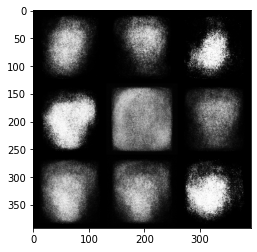

Starting epoch 5...
g_loss: 0.607649028301239, d_loss: 0.345975399017334


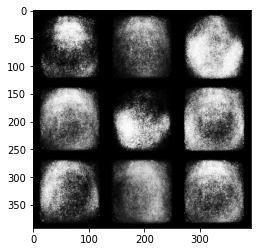

Starting epoch 6...
g_loss: 0.7748839855194092, d_loss: 1.17894446849823


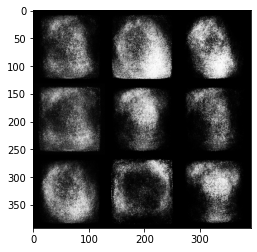

Starting epoch 7...
g_loss: 0.8560003042221069, d_loss: 0.33957338333129883


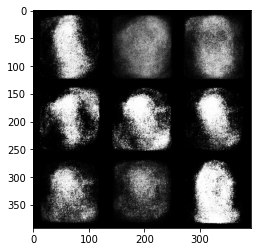

Starting epoch 8...
g_loss: 1.4519425630569458, d_loss: 1.3756213188171387


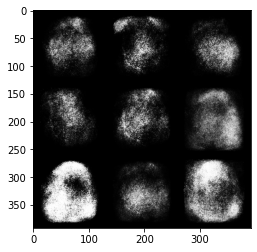

Starting epoch 9...
g_loss: 1.5573841333389282, d_loss: 1.2265467643737793


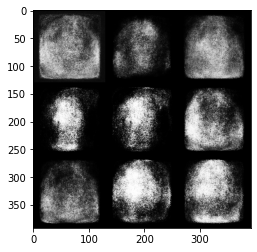

Starting epoch 10...
g_loss: 1.2726759910583496, d_loss: 0.2836722135543823


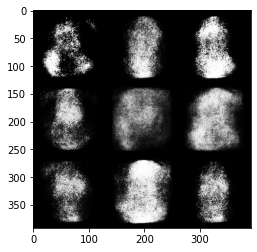

Starting epoch 11...
g_loss: 1.0403358936309814, d_loss: 0.8475502729415894


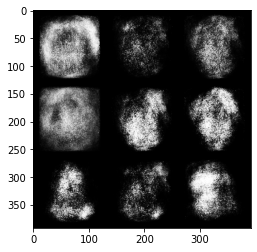

Starting epoch 12...
g_loss: 1.285374402999878, d_loss: 2.0809617042541504


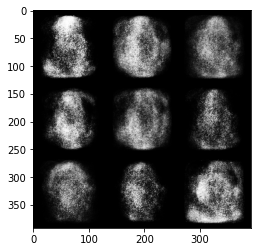

Starting epoch 13...
g_loss: 1.663818597793579, d_loss: 1.2598813772201538


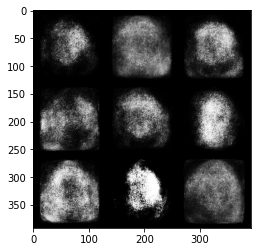

Starting epoch 14...
g_loss: 1.1205278635025024, d_loss: 0.7186398506164551


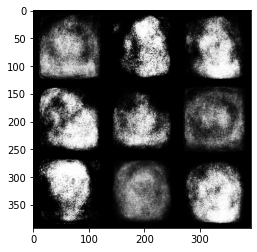

Starting epoch 15...
g_loss: 2.5322861671447754, d_loss: 1.6363773345947266


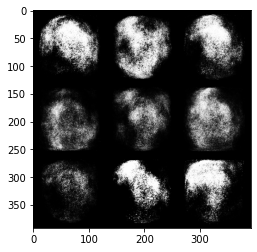

Starting epoch 16...
g_loss: 1.5555659532546997, d_loss: 0.428057998418808


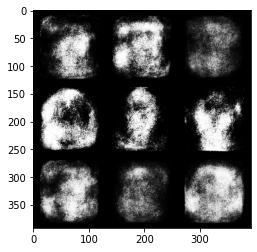

Starting epoch 17...
g_loss: 0.9468538761138916, d_loss: 0.5974388122558594


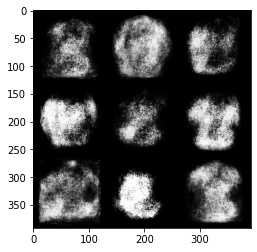

Starting epoch 18...
g_loss: 1.2425862550735474, d_loss: 0.38998132944107056


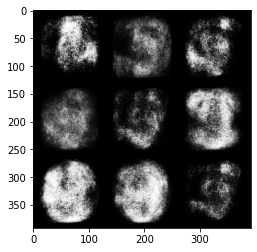

Starting epoch 19...
g_loss: 1.4643611907958984, d_loss: 1.7498632669448853


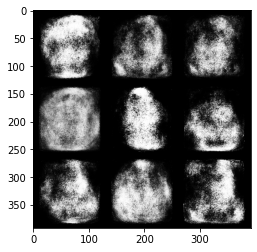

Starting epoch 20...
g_loss: 1.891640067100525, d_loss: 1.7741228342056274


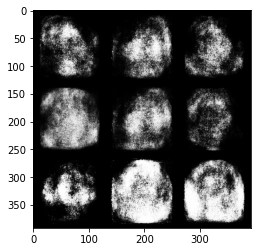

Starting epoch 21...
g_loss: 2.250706434249878, d_loss: 1.7743521928787231


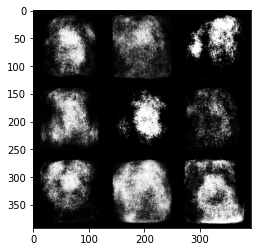

Starting epoch 22...
g_loss: 1.6094582080841064, d_loss: 0.4138079285621643


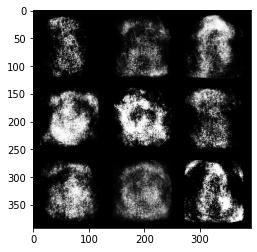

Starting epoch 23...
g_loss: 2.3618581295013428, d_loss: 0.5246281623840332


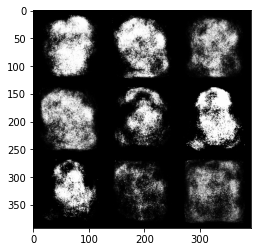

Starting epoch 24...
g_loss: 1.7514100074768066, d_loss: 0.19458867609500885


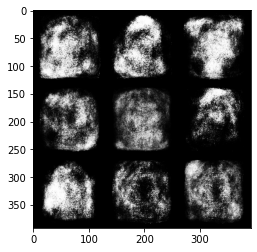

Starting epoch 25...
g_loss: 2.028554916381836, d_loss: 0.6197563409805298


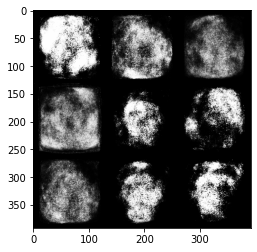

Starting epoch 26...
g_loss: 1.708223819732666, d_loss: 1.5350925922393799


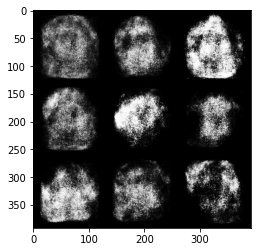

Starting epoch 27...
g_loss: 1.7829034328460693, d_loss: 0.21629327535629272


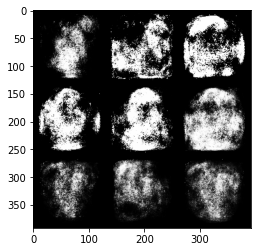

Starting epoch 28...
g_loss: 2.114062786102295, d_loss: 0.115029476583004


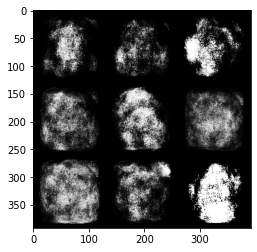

Starting epoch 29...
g_loss: 1.0154774188995361, d_loss: 1.4235395193099976


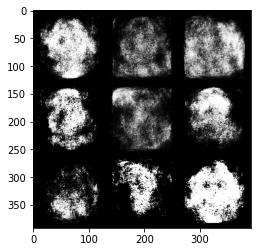

Starting epoch 30...
g_loss: 1.2236120700836182, d_loss: 0.34281662106513977


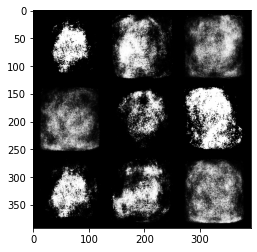

Starting epoch 31...
g_loss: 1.6266144514083862, d_loss: 0.3291046619415283


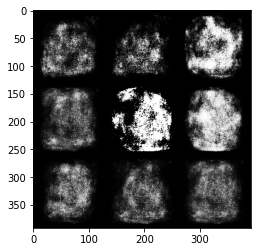

Starting epoch 32...
g_loss: 1.6188147068023682, d_loss: 0.25981807708740234


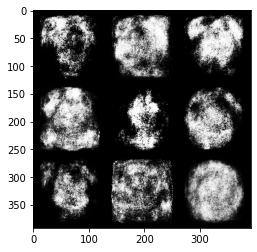

Starting epoch 33...
g_loss: 0.9502704739570618, d_loss: 0.40992239117622375


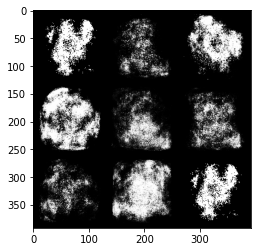

Starting epoch 34...
g_loss: 1.9481674432754517, d_loss: 0.6447871923446655


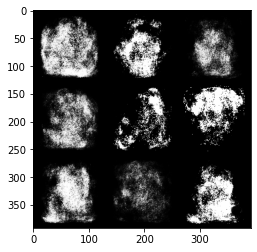

Starting epoch 35...
g_loss: 2.6432108879089355, d_loss: 0.5972020626068115


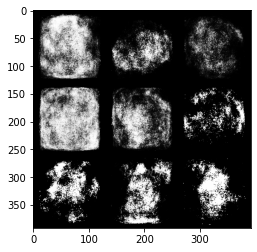

Starting epoch 36...
g_loss: 2.1476261615753174, d_loss: 1.0537376403808594


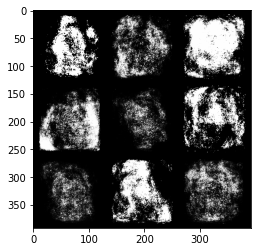

Starting epoch 37...
g_loss: 2.773665428161621, d_loss: 0.7691344618797302


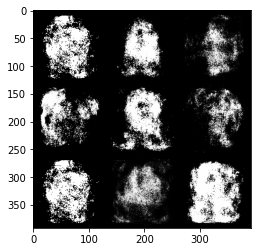

Starting epoch 38...
g_loss: 2.806816339492798, d_loss: 50.18230438232422


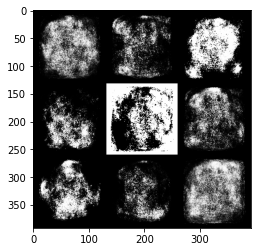

Starting epoch 39...
g_loss: 1.4595094919204712, d_loss: 0.06470924615859985


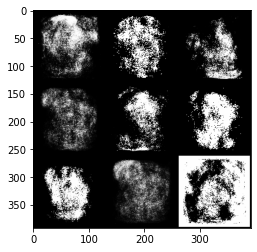

Starting epoch 40...
g_loss: 1.8921236991882324, d_loss: 50.33506393432617


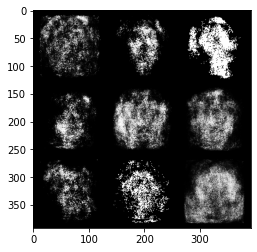

Starting epoch 41...
g_loss: 3.1663708686828613, d_loss: 0.04505237936973572


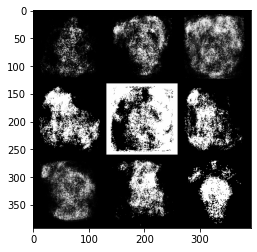

Starting epoch 42...
g_loss: 1.9928209781646729, d_loss: 0.04070916771888733


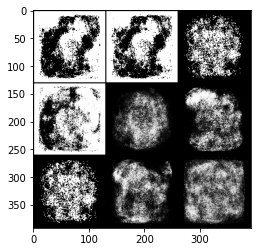

Starting epoch 43...
g_loss: 2.5739948749542236, d_loss: 0.08832693845033646


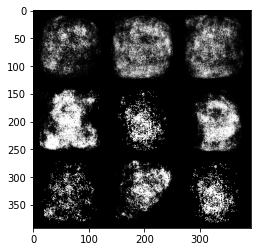

Starting epoch 44...
g_loss: 3.18351674079895, d_loss: 0.12948113679885864


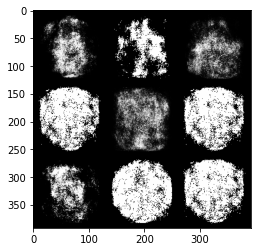

Starting epoch 45...
g_loss: 3.6004233360290527, d_loss: 0.1740679144859314


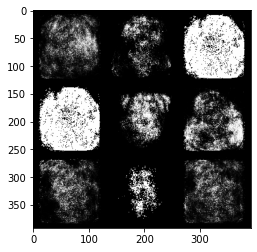

Starting epoch 46...
g_loss: 2.234440326690674, d_loss: 0.24774587154388428


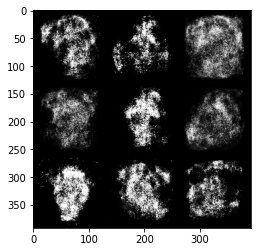

Starting epoch 47...
g_loss: 1.5618820190429688, d_loss: 1.0444093942642212


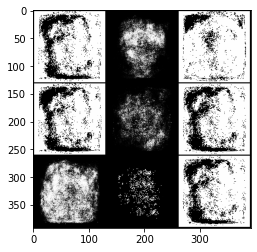

Starting epoch 48...
g_loss: 2.9845571517944336, d_loss: 0.19188937544822693


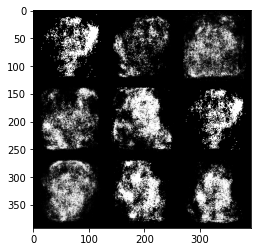

Starting epoch 49...
g_loss: 52.55600357055664, d_loss: 0.14517280459403992


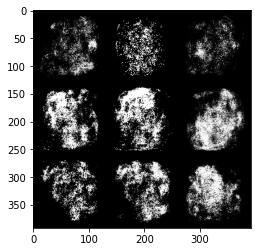

Starting epoch 50...
g_loss: 2.4370779991149902, d_loss: 3.2257847785949707


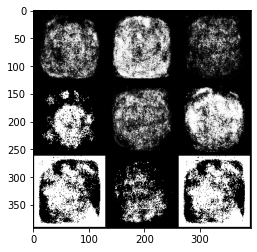

Starting epoch 51...
g_loss: 51.41841125488281, d_loss: 0.1060551181435585


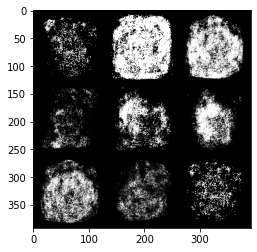

Starting epoch 52...
g_loss: 4.665193557739258, d_loss: 0.24359886348247528


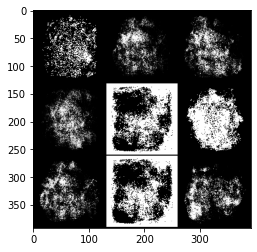

Starting epoch 53...
g_loss: 1.651674747467041, d_loss: 1.0294641256332397


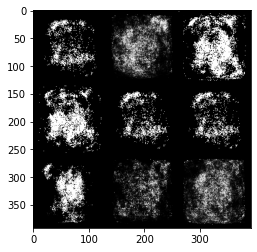

Starting epoch 54...
g_loss: 2.9636783599853516, d_loss: 0.03236052393913269


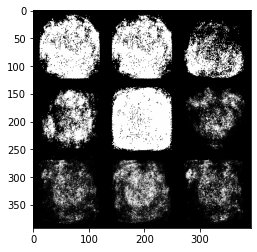

Starting epoch 55...
g_loss: 6.475639343261719, d_loss: 0.02507953904569149


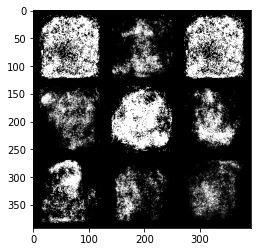

Starting epoch 56...
g_loss: 4.662595748901367, d_loss: 0.11968662589788437


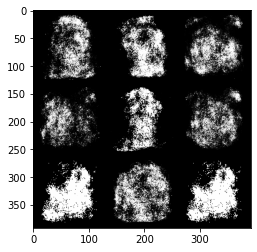

Starting epoch 57...
g_loss: 4.359496116638184, d_loss: 0.5430694818496704


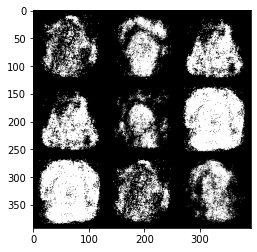

Starting epoch 58...
g_loss: 3.5586187839508057, d_loss: 0.020257407799363136


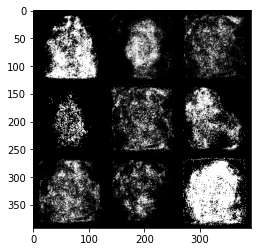

Starting epoch 59...
g_loss: 3.778111696243286, d_loss: 0.34640559554100037


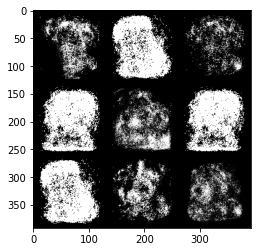

Starting epoch 60...
g_loss: 4.262791633605957, d_loss: 0.28388312458992004


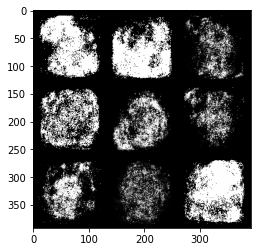

Starting epoch 61...
g_loss: 5.820287704467773, d_loss: 0.7306063175201416


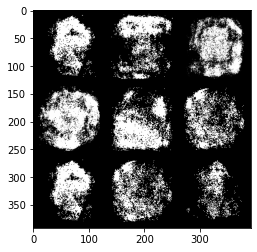

Starting epoch 62...
g_loss: 4.716264724731445, d_loss: 0.024027248844504356


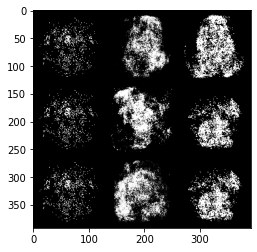

Starting epoch 63...
g_loss: 4.576650619506836, d_loss: 0.0053318822756409645


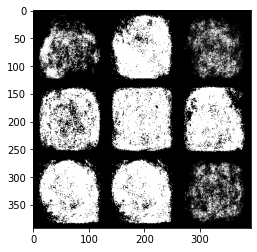

Starting epoch 64...
g_loss: 7.254765033721924, d_loss: 0.016825390979647636


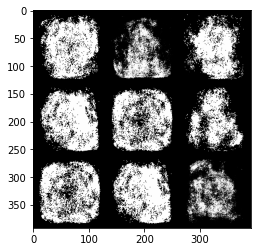

Starting epoch 65...
g_loss: 7.379136562347412, d_loss: 0.0030469228513538837


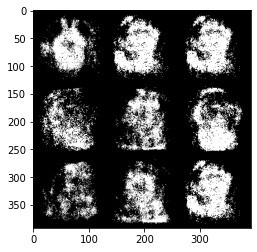

Starting epoch 66...
g_loss: 4.23537015914917, d_loss: 0.229234978556633


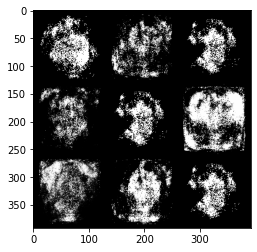

Starting epoch 67...
g_loss: 10.296844482421875, d_loss: 0.8275928497314453


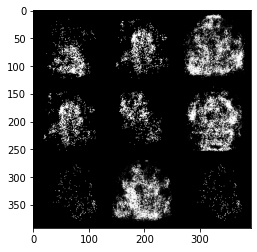

Starting epoch 68...
g_loss: 7.456474304199219, d_loss: 0.21370652318000793


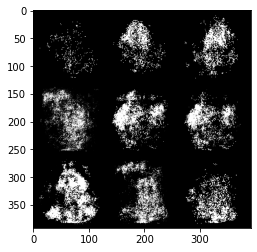

Starting epoch 69...
g_loss: 2.4678139686584473, d_loss: 0.5353875756263733


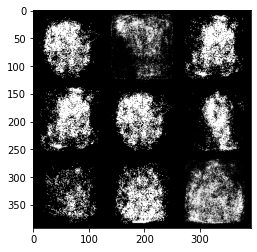

Starting epoch 70...
g_loss: 7.879016876220703, d_loss: 0.02810067869722843


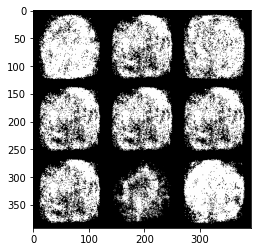

Starting epoch 71...
g_loss: 6.827200889587402, d_loss: 0.14421997964382172


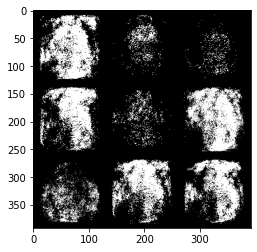

Starting epoch 72...
g_loss: 5.993295669555664, d_loss: 50.00251388549805


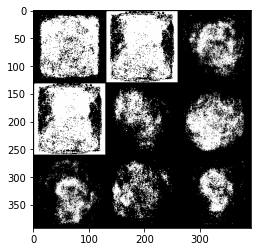

Starting epoch 73...
g_loss: 6.6792707443237305, d_loss: 0.006120139267295599


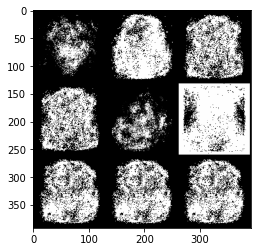

Starting epoch 74...
g_loss: 3.603862762451172, d_loss: 0.18215632438659668


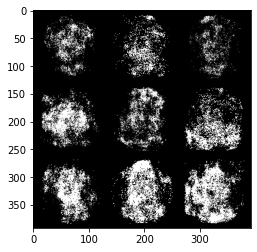

Starting epoch 75...
g_loss: 53.56617736816406, d_loss: 0.008588062599301338


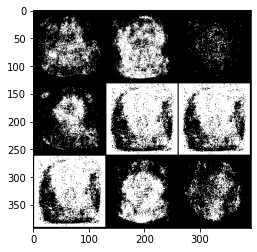

Starting epoch 76...
g_loss: 2.0803616046905518, d_loss: 0.8346079587936401


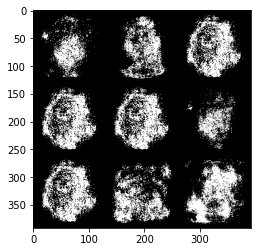

Starting epoch 77...
g_loss: 8.019128799438477, d_loss: 0.23961783945560455


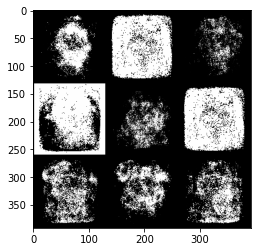

Starting epoch 78...
g_loss: 6.663884162902832, d_loss: 0.630303144454956


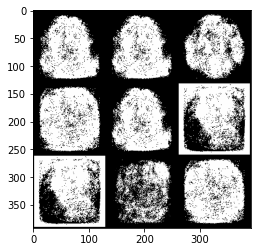

Starting epoch 79...
g_loss: 6.00582218170166, d_loss: 0.024284277111291885


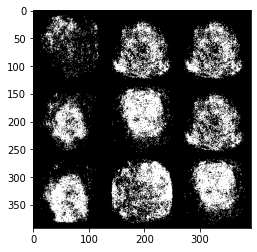

Starting epoch 80...
g_loss: 7.343629837036133, d_loss: 0.006351807154715061


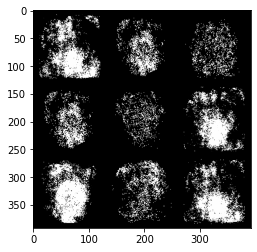

Starting epoch 81...
g_loss: 5.1986083984375, d_loss: 0.0002600928710307926


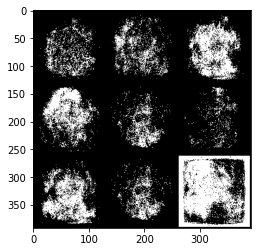

Starting epoch 82...
g_loss: 53.72880554199219, d_loss: 0.0005235133576206863


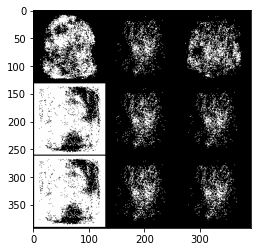

Starting epoch 83...
g_loss: 11.500371932983398, d_loss: 3.1888525882095564e-06


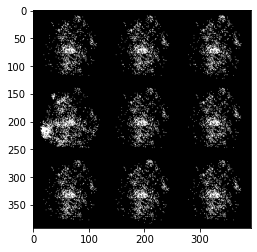

Starting epoch 84...
g_loss: 6.1181511878967285, d_loss: 0.007190993521362543


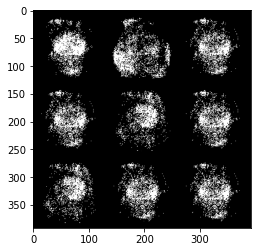

Starting epoch 85...
g_loss: 13.171989440917969, d_loss: 1.3560149454860948e-05


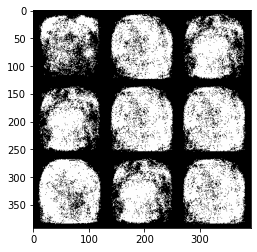

Starting epoch 86...
g_loss: 11.244709968566895, d_loss: 0.00020231914822943509


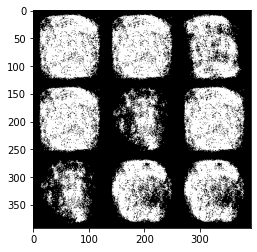

Starting epoch 87...
g_loss: 7.978972434997559, d_loss: 0.022266598418354988


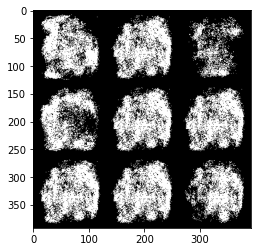

Starting epoch 88...
g_loss: 10.93596076965332, d_loss: 0.00011180085857631639


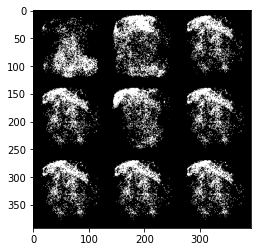

Starting epoch 89...
g_loss: 9.691997528076172, d_loss: 0.00012443348532542586


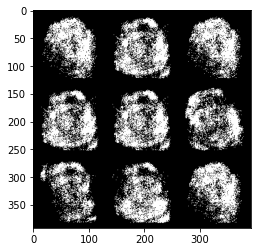

Starting epoch 90...
g_loss: 11.651517868041992, d_loss: 0.0022609313018620014


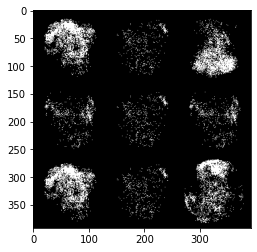

Starting epoch 91...
g_loss: 9.948907852172852, d_loss: 0.0


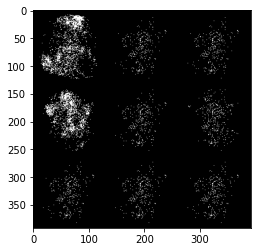

Starting epoch 92...
g_loss: 16.904577255249023, d_loss: 3.5762795391747204e-07


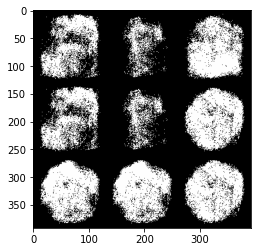

Starting epoch 93...
g_loss: 20.645536422729492, d_loss: 0.0


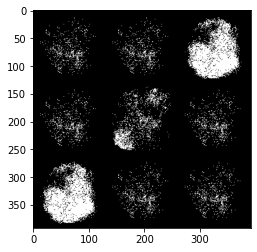

Starting epoch 94...
g_loss: 12.34480094909668, d_loss: 2.0415005565155298e-05


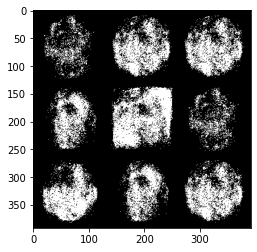

Starting epoch 95...
g_loss: 11.144428253173828, d_loss: 1.4364924936671741e-05


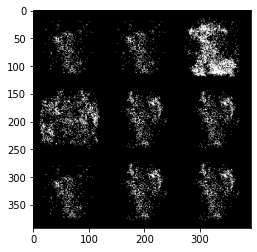

Starting epoch 96...
g_loss: 21.12047576904297, d_loss: 0.0


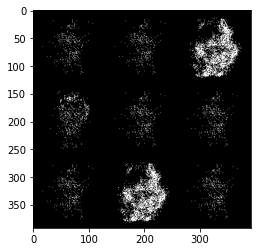

Starting epoch 97...
g_loss: 19.177860260009766, d_loss: 0.04286657273769379


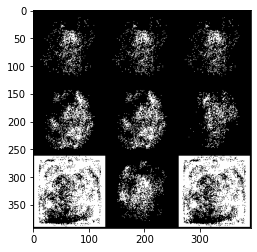

Starting epoch 98...
g_loss: 14.969481468200684, d_loss: 0.0001878494949778542


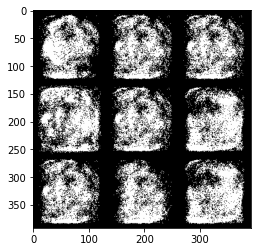

Starting epoch 99...
g_loss: 8.161869049072266, d_loss: 0.00014441274106502533


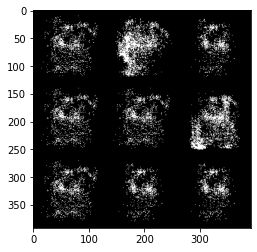

Starting epoch 100...
g_loss: 100.0, d_loss: 0.00014632100646849722


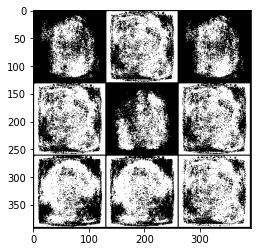

Starting epoch 101...
g_loss: 100.0, d_loss: 0.0


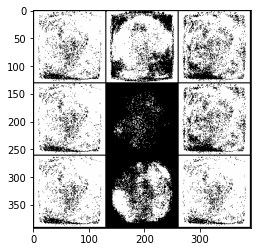

Starting epoch 102...
g_loss: 16.114887237548828, d_loss: 7.450586281265714e-07


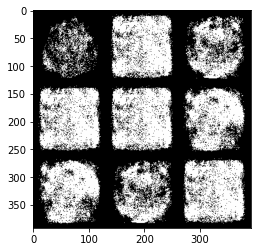

Starting epoch 103...
g_loss: 7.403719902038574, d_loss: 4.852010533795692e-05


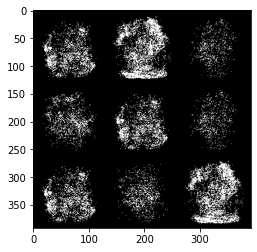

Starting epoch 104...
g_loss: 12.118754386901855, d_loss: 2.145769940398168e-06


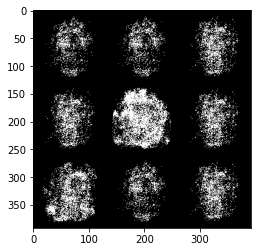

Starting epoch 105...
g_loss: 14.212104797363281, d_loss: 9.090228559216484e-05


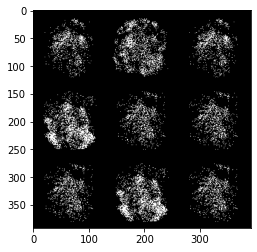

Starting epoch 106...
g_loss: 5.609260559082031, d_loss: 0.00011364607780706137


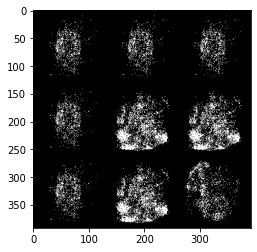

Starting epoch 107...
g_loss: 16.701244354248047, d_loss: 4.3990137783112004e-05


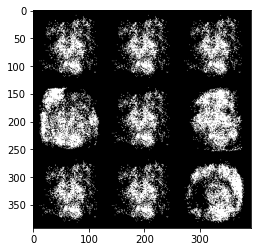

Starting epoch 108...
g_loss: 7.382561683654785, d_loss: 0.002490689279511571


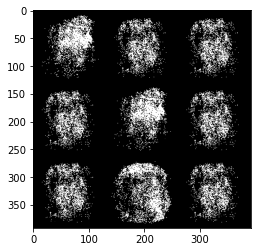

Starting epoch 109...
g_loss: 21.556915283203125, d_loss: 0.009677899070084095


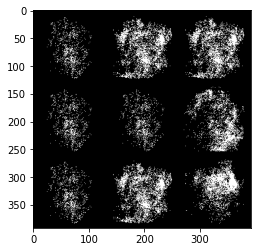

Starting epoch 110...
g_loss: 19.23052215576172, d_loss: 7.838072633603588e-06


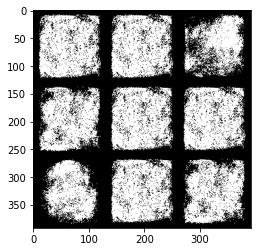

Starting epoch 111...
g_loss: 14.661840438842773, d_loss: 2.9802322387695312e-08


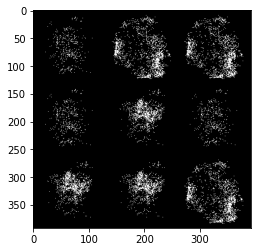

Starting epoch 112...
g_loss: 16.47150230407715, d_loss: 8.672551302879583e-06


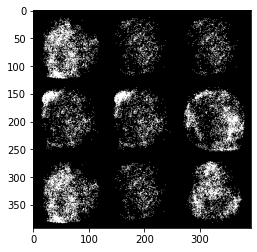

Starting epoch 113...
g_loss: 7.535965919494629, d_loss: 0.0009977627778425813


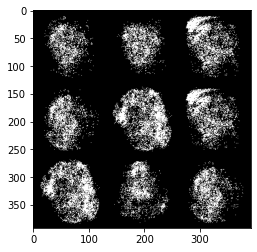

Starting epoch 114...
g_loss: 9.234909057617188, d_loss: 0.0


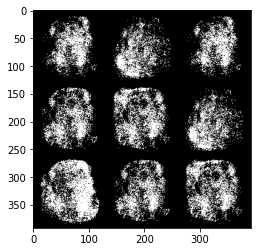

Starting epoch 115...
g_loss: 15.811491012573242, d_loss: 4.3602431105682626e-05


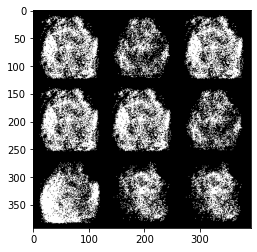

Starting epoch 116...
g_loss: 18.375595092773438, d_loss: 5.960465188081798e-08


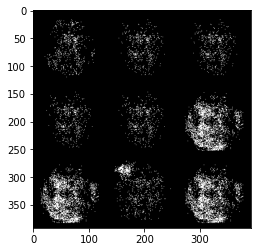

Starting epoch 117...
g_loss: 13.045120239257812, d_loss: 1.966957142940373e-06


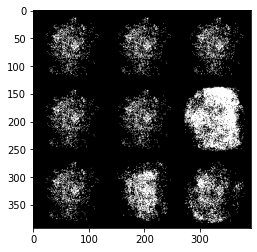

Starting epoch 118...
g_loss: 15.375061988830566, d_loss: 0.0


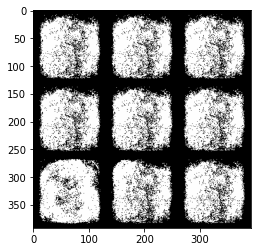

Starting epoch 119...
g_loss: 13.198293685913086, d_loss: 2.08616665986483e-06


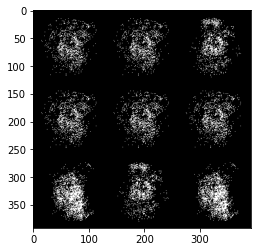

Starting epoch 120...
g_loss: 12.667344093322754, d_loss: 4.887603154202225e-06


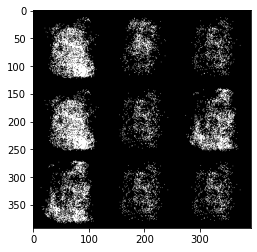

Starting epoch 121...
g_loss: 56.721046447753906, d_loss: 1.3709087625102256e-06


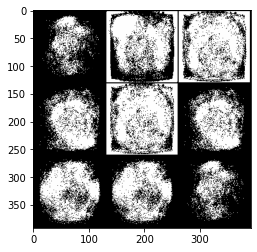

Starting epoch 122...
g_loss: 100.0, d_loss: 0.0


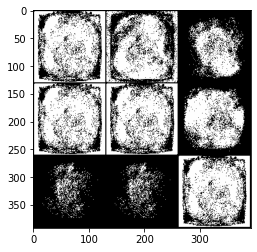

Starting epoch 123...
g_loss: 15.826700210571289, d_loss: 2.9802322387695312e-08


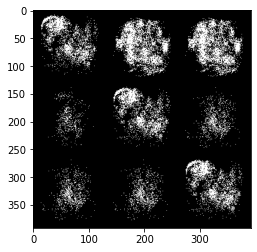

Starting epoch 124...
g_loss: 62.43512725830078, d_loss: 0.0


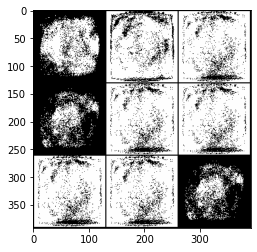

Starting epoch 125...
g_loss: 100.0, d_loss: 0.0


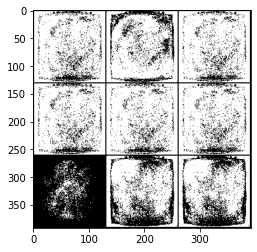

Starting epoch 126...
g_loss: 100.0, d_loss: 0.0


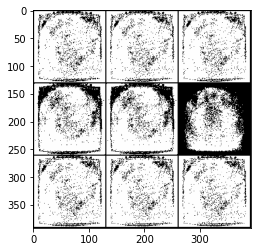

Starting epoch 127...
g_loss: 17.13556480407715, d_loss: 5.90089484830969e-06


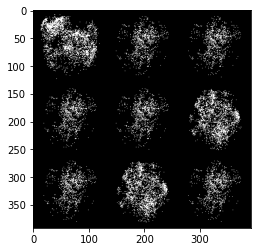

Starting epoch 128...
g_loss: 5.182744026184082, d_loss: 0.0009767861338332295


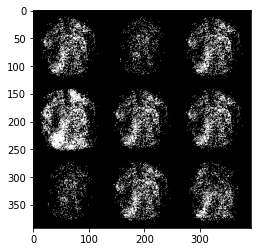

Starting epoch 129...
g_loss: 18.303014755249023, d_loss: 5.960465188081798e-08


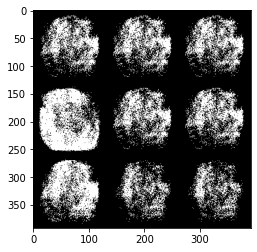

Starting epoch 130...
g_loss: 15.942232131958008, d_loss: 0.0


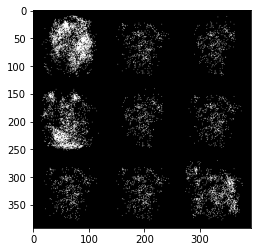

Starting epoch 131...
g_loss: 16.93773651123047, d_loss: 0.0


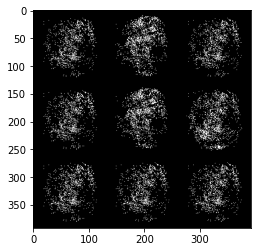

Starting epoch 132...
g_loss: 15.261716842651367, d_loss: 0.0


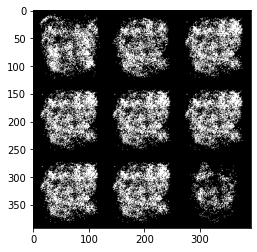

Starting epoch 133...
g_loss: 17.298168182373047, d_loss: 1.5318622899940237e-05


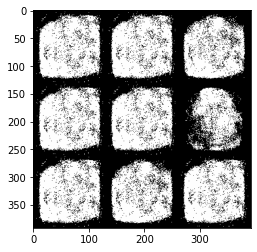

Starting epoch 134...
g_loss: 16.802764892578125, d_loss: 0.0


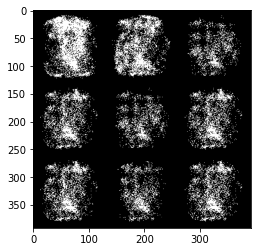

Starting epoch 135...
g_loss: 16.998952865600586, d_loss: 1.49011640360186e-07


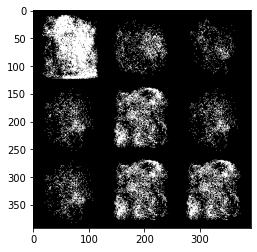

Starting epoch 136...
g_loss: 11.549297332763672, d_loss: 0.00020854028116445988


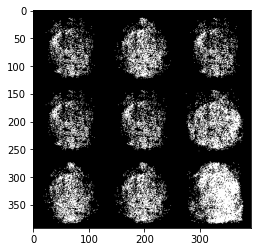

Starting epoch 137...
g_loss: 13.729928970336914, d_loss: 1.3411060990620172e-06


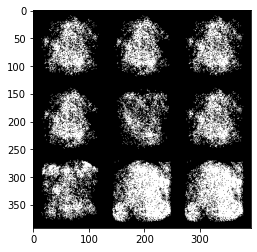

Starting epoch 138...
g_loss: 15.98110294342041, d_loss: 0.0


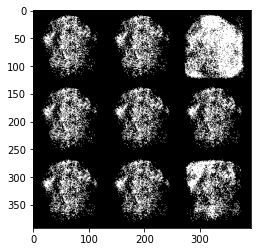

Starting epoch 139...
g_loss: 17.181306838989258, d_loss: 8.94070240065048e-07


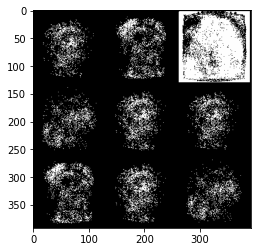

Starting epoch 140...
g_loss: 13.770393371582031, d_loss: 3.2186583212023834e-06


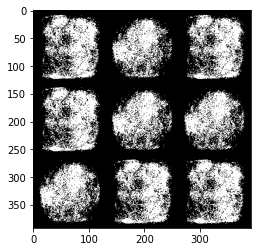

Starting epoch 141...
g_loss: 32.07109451293945, d_loss: 5.960465188081798e-08


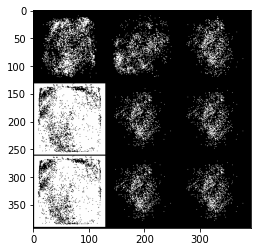

Starting epoch 142...
g_loss: 12.437206268310547, d_loss: 2.9802322387695312e-08


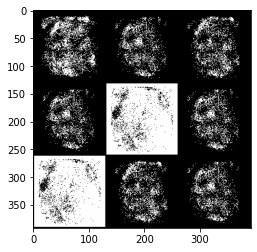

Starting epoch 143...
g_loss: 22.688129425048828, d_loss: 0.0


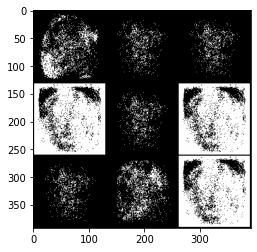

Starting epoch 144...
g_loss: 52.19097137451172, d_loss: 0.0


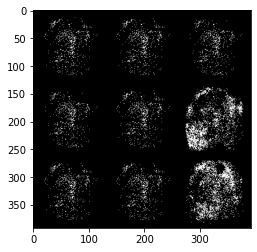

Starting epoch 145...
g_loss: 78.35275268554688, d_loss: 0.0


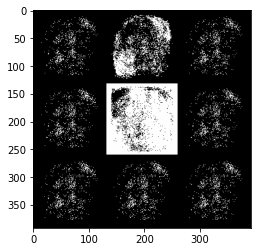

Starting epoch 146...
g_loss: 100.0, d_loss: 0.0


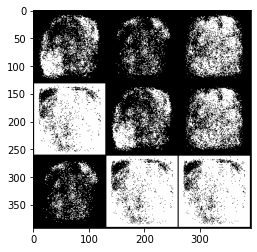

Starting epoch 147...
g_loss: 100.0, d_loss: 0.0


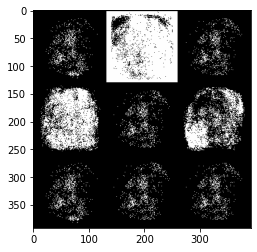

Starting epoch 148...
g_loss: 73.69082641601562, d_loss: 0.0


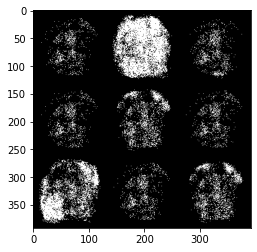

Starting epoch 149...
g_loss: 62.72521209716797, d_loss: 0.0


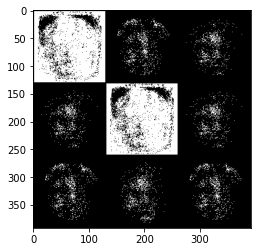

Starting epoch 150...
g_loss: 37.571693420410156, d_loss: 0.0


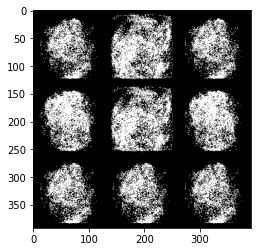

Starting epoch 151...
g_loss: 13.736133575439453, d_loss: 9.834776619754848e-07


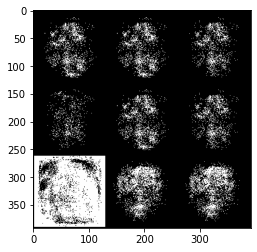

Starting epoch 152...
g_loss: 15.812999725341797, d_loss: 0.0


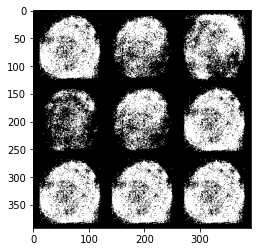

Starting epoch 153...
g_loss: 26.676422119140625, d_loss: 0.0


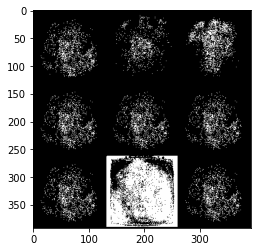

Starting epoch 154...
g_loss: 68.5641860961914, d_loss: 0.0


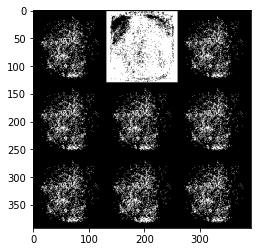

Starting epoch 155...
g_loss: 32.29936218261719, d_loss: 0.0


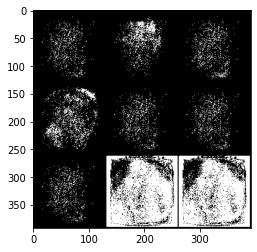

Starting epoch 156...
g_loss: 66.42808532714844, d_loss: 0.0


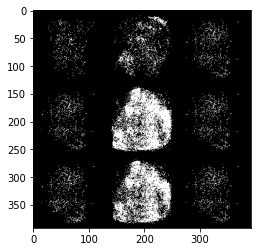

Starting epoch 157...
g_loss: 60.788299560546875, d_loss: 0.0


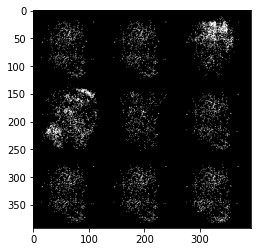

Starting epoch 158...
g_loss: 65.57791137695312, d_loss: 0.0


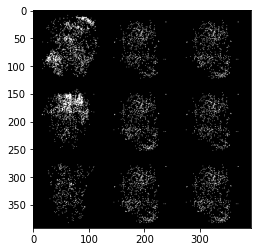

Starting epoch 159...
g_loss: 76.3963851928711, d_loss: 0.0


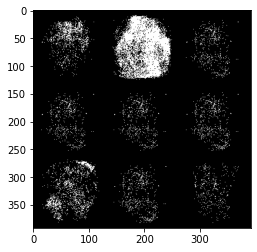

Starting epoch 160...
g_loss: 86.69239807128906, d_loss: 0.0


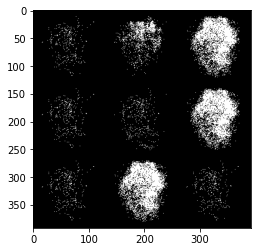

Starting epoch 161...
g_loss: 100.0, d_loss: 0.0


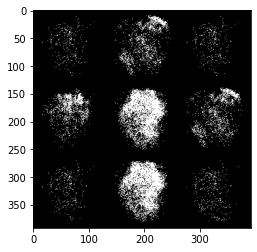

Starting epoch 162...
g_loss: 83.25767517089844, d_loss: 0.0


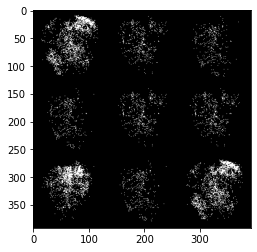

Starting epoch 163...
g_loss: 100.0, d_loss: 0.0


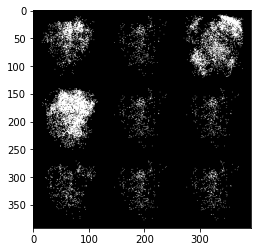

Starting epoch 164...
g_loss: 81.37395477294922, d_loss: 0.0


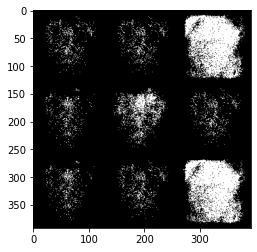

Starting epoch 165...
g_loss: 51.69776916503906, d_loss: 0.0


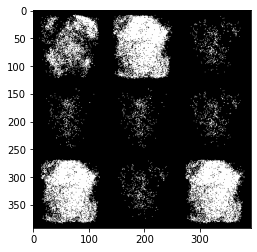

Starting epoch 166...
g_loss: 100.0, d_loss: 0.0


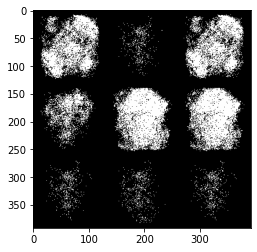

Starting epoch 167...
g_loss: 100.0, d_loss: 0.0


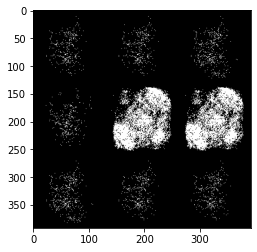

Starting epoch 168...
g_loss: 67.79554748535156, d_loss: 0.0


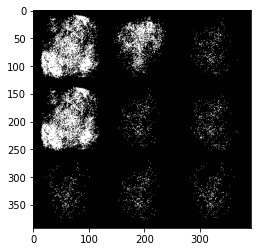

Starting epoch 169...
g_loss: 100.0, d_loss: 3.33103609085083


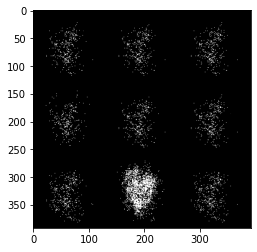

Starting epoch 170...
g_loss: 100.0, d_loss: 0.0


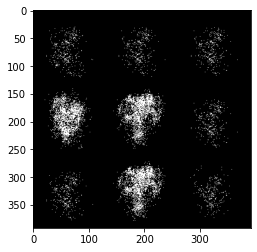

Starting epoch 171...
g_loss: 100.0, d_loss: 0.0


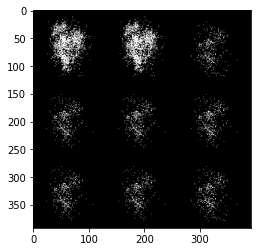

Starting epoch 172...
g_loss: 100.0, d_loss: 0.0


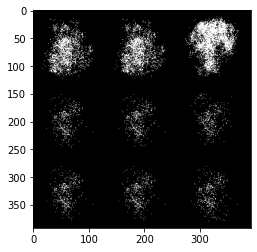

Starting epoch 173...
g_loss: 85.14016723632812, d_loss: 0.0


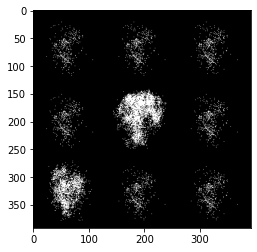

Starting epoch 174...
g_loss: 100.0, d_loss: 0.0


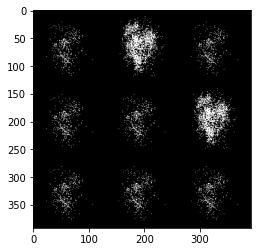

Starting epoch 175...
g_loss: 100.0, d_loss: 0.0


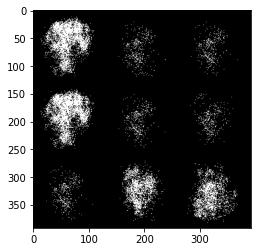

Starting epoch 176...
g_loss: 100.0, d_loss: 0.0


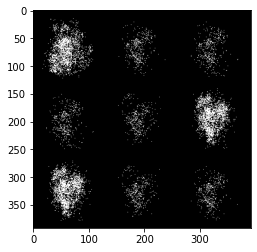

Starting epoch 177...
g_loss: 100.0, d_loss: 0.0


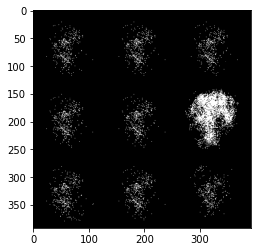

Starting epoch 178...
g_loss: 100.0, d_loss: 0.0


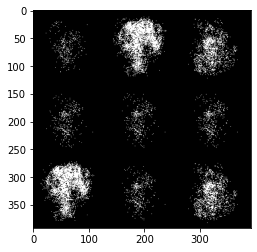

Starting epoch 179...
g_loss: 78.58419799804688, d_loss: 0.0


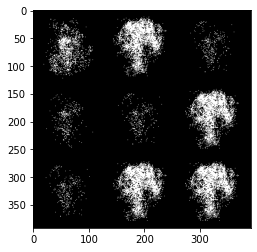

Starting epoch 180...
g_loss: 83.25232696533203, d_loss: 0.0


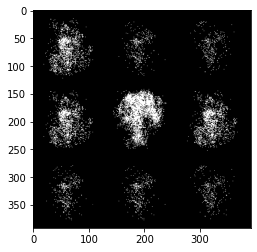

Starting epoch 181...
g_loss: 81.05467987060547, d_loss: 0.0


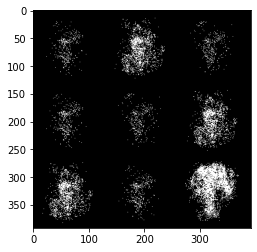

Starting epoch 182...
g_loss: 91.39979553222656, d_loss: 0.0


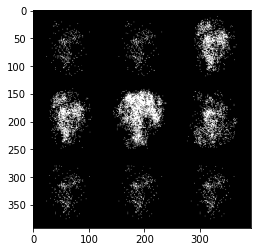

Starting epoch 183...
g_loss: 100.0, d_loss: 0.0


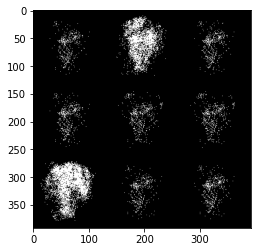

Starting epoch 184...
g_loss: 100.0, d_loss: 0.0


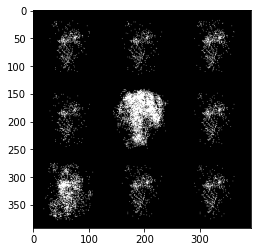

Starting epoch 185...
g_loss: 92.64881134033203, d_loss: 0.0


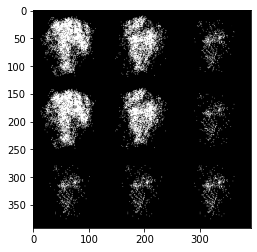

Starting epoch 186...
g_loss: 100.0, d_loss: 0.0


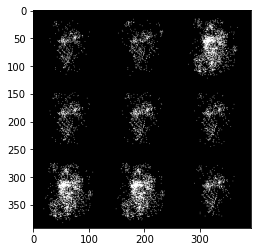

Starting epoch 187...
g_loss: 100.0, d_loss: 0.0


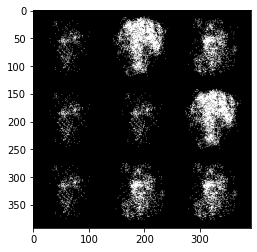

Starting epoch 188...
g_loss: 100.0, d_loss: 0.0


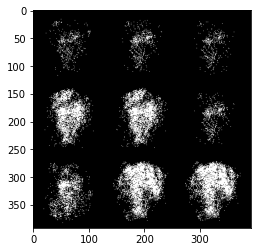

Starting epoch 189...
g_loss: 100.0, d_loss: 0.0


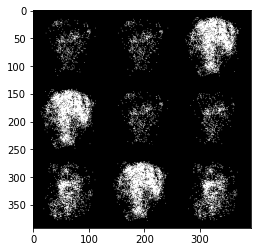

Starting epoch 190...
g_loss: 100.0, d_loss: 0.0


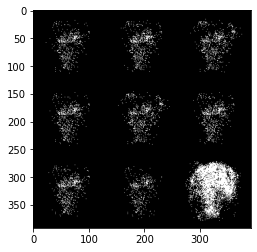

Starting epoch 191...
g_loss: 100.0, d_loss: 0.0


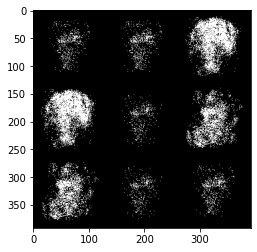

Starting epoch 192...
g_loss: 100.0, d_loss: 0.0


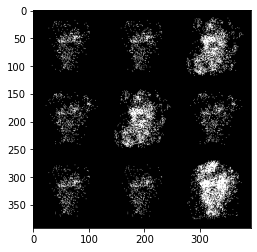

Starting epoch 193...
g_loss: 100.0, d_loss: 0.0


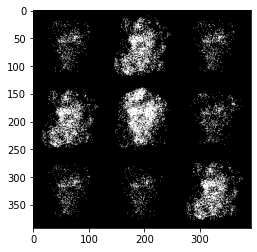

Starting epoch 194...
g_loss: 100.0, d_loss: 0.0


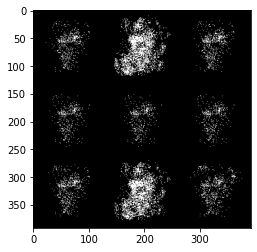

Starting epoch 195...
g_loss: 100.0, d_loss: 0.0


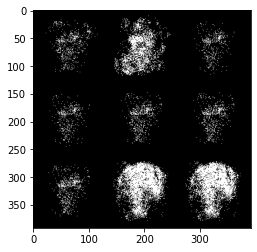

Starting epoch 196...
g_loss: 100.0, d_loss: 0.0


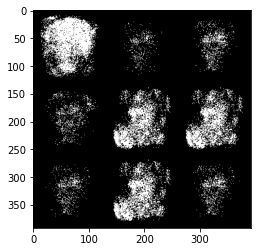

Starting epoch 197...
g_loss: 100.0, d_loss: 0.0


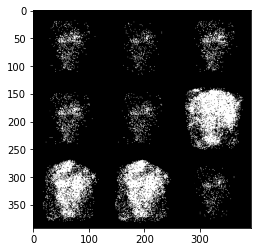

Starting epoch 198...
g_loss: 100.0, d_loss: 0.0


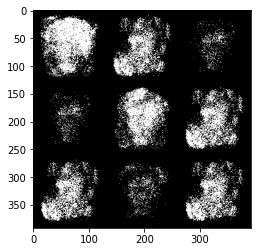

Starting epoch 199...
g_loss: 100.0, d_loss: 0.0


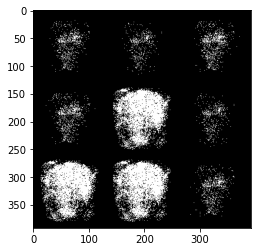

Starting epoch 200...
g_loss: 100.0, d_loss: 0.0


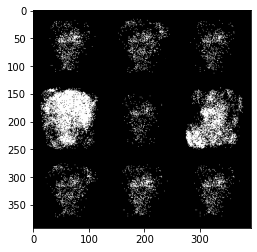

Starting epoch 201...
g_loss: 100.0, d_loss: 0.0


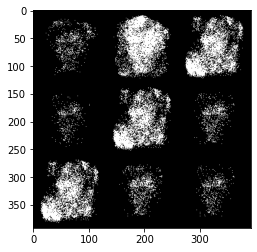

Starting epoch 202...
g_loss: 100.0, d_loss: 0.0


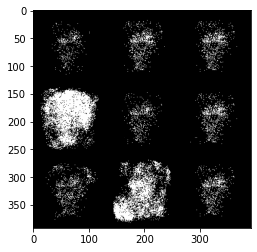

Starting epoch 203...
g_loss: 100.0, d_loss: 0.0


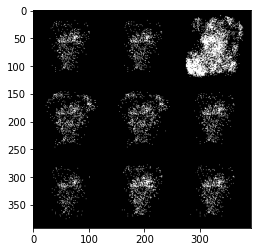

Starting epoch 204...
g_loss: 100.0, d_loss: 0.0


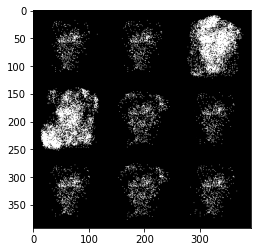

Starting epoch 205...
g_loss: 100.0, d_loss: 0.0


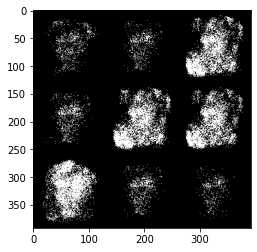

Starting epoch 206...
g_loss: 100.0, d_loss: 0.0


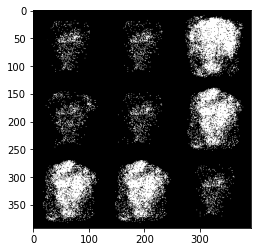

Starting epoch 207...
g_loss: 80.67432403564453, d_loss: 0.0


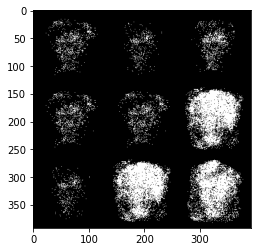

Starting epoch 208...
g_loss: 100.0, d_loss: 0.0


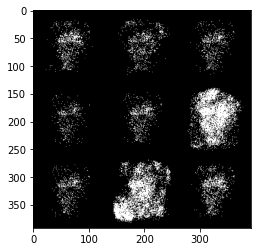

Starting epoch 209...
g_loss: 100.0, d_loss: 0.0


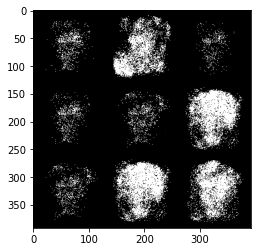

Starting epoch 210...
g_loss: 100.0, d_loss: 0.0


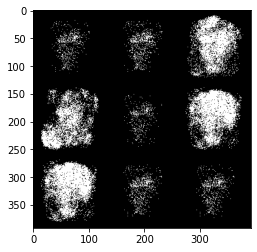

Starting epoch 211...
g_loss: 100.0, d_loss: 0.0


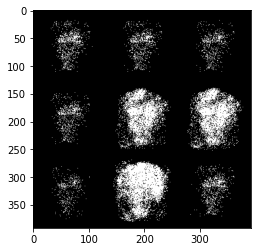

Starting epoch 212...
g_loss: 100.0, d_loss: 0.0


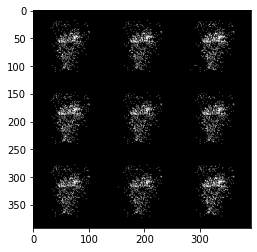

Starting epoch 213...
g_loss: 100.0, d_loss: 0.0


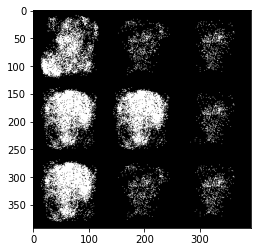

Starting epoch 214...
g_loss: 100.0, d_loss: 0.0


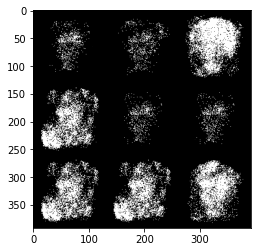

Starting epoch 215...
g_loss: 100.0, d_loss: 0.0


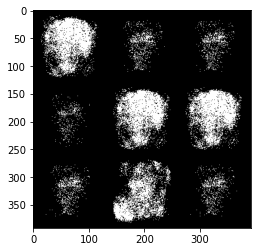

Starting epoch 216...
g_loss: 100.0, d_loss: 0.0


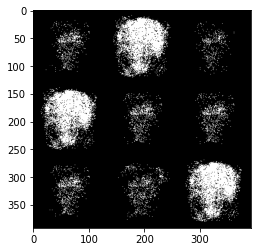

Starting epoch 217...
g_loss: 100.0, d_loss: 0.0


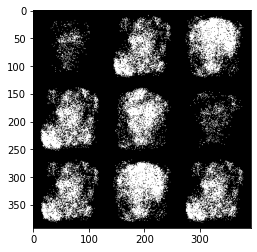

Starting epoch 218...
g_loss: 100.0, d_loss: 0.0


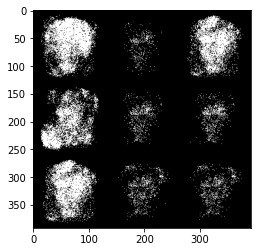

Starting epoch 219...
g_loss: 100.0, d_loss: 0.0


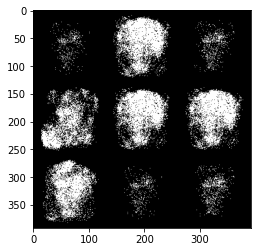

Starting epoch 220...
g_loss: 100.0, d_loss: 0.0


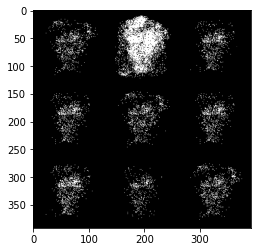

Starting epoch 221...
g_loss: 100.0, d_loss: 0.0


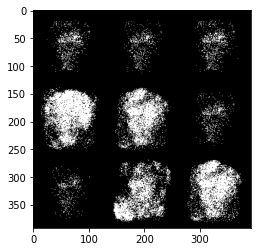

Starting epoch 222...
g_loss: 100.0, d_loss: 0.0


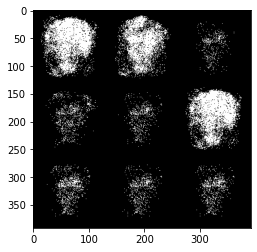

Starting epoch 223...
g_loss: 100.0, d_loss: 0.0


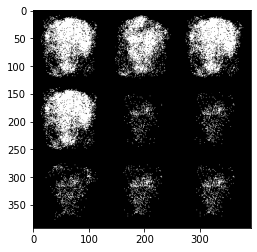

Starting epoch 224...
g_loss: 100.0, d_loss: 0.0


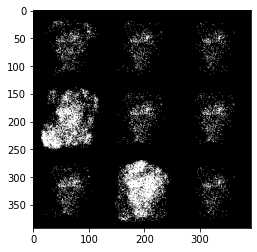

Starting epoch 225...
g_loss: 100.0, d_loss: 0.0


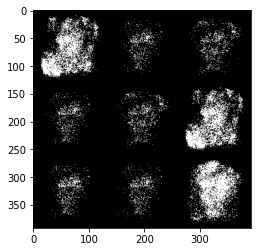

Starting epoch 226...
g_loss: 100.0, d_loss: 0.0


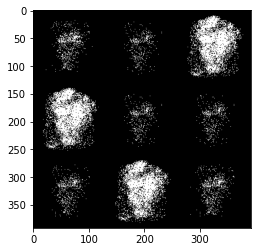

Starting epoch 227...
g_loss: 100.0, d_loss: 0.0


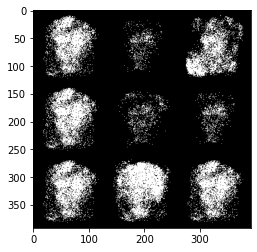

Starting epoch 228...
g_loss: 100.0, d_loss: 0.0


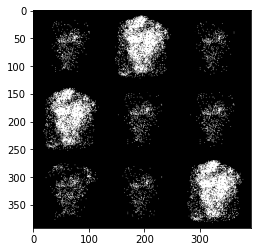

Starting epoch 229...
g_loss: 100.0, d_loss: 0.0


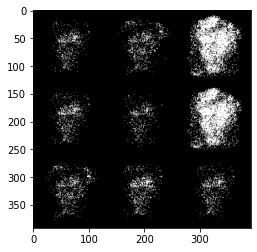

Starting epoch 230...
g_loss: 100.0, d_loss: 0.0


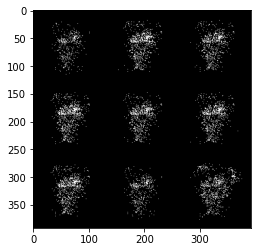

Starting epoch 231...
g_loss: 100.0, d_loss: 0.0


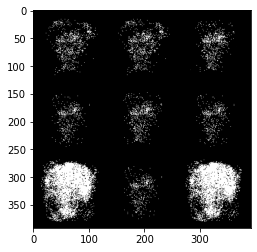

Starting epoch 232...
g_loss: 100.0, d_loss: 0.0


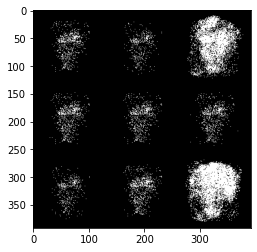

Starting epoch 233...
g_loss: 100.0, d_loss: 0.0


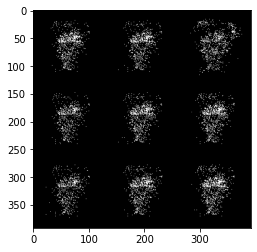

Starting epoch 234...
g_loss: 100.0, d_loss: 0.0


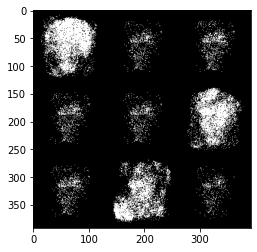

Starting epoch 235...
g_loss: 100.0, d_loss: 0.0


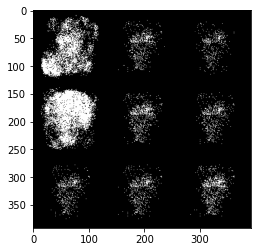

Starting epoch 236...
g_loss: 100.0, d_loss: 0.0


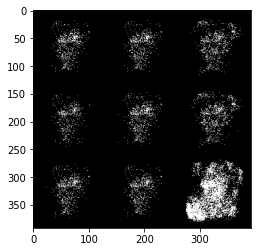

Starting epoch 237...
g_loss: 100.0, d_loss: 0.0


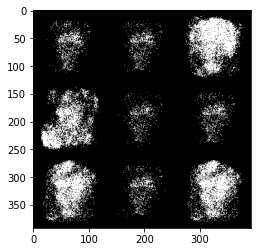

Starting epoch 238...
g_loss: 100.0, d_loss: 0.0


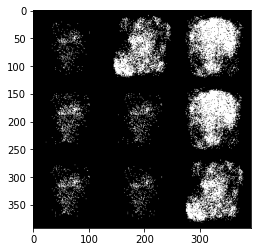

Starting epoch 239...
g_loss: 100.0, d_loss: 0.0


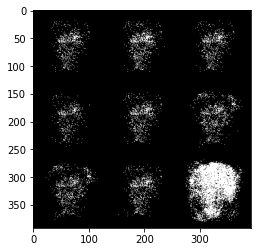

Starting epoch 240...
g_loss: 100.0, d_loss: 0.0


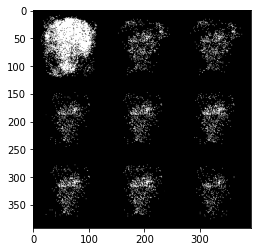

Starting epoch 241...
g_loss: 100.0, d_loss: 0.0


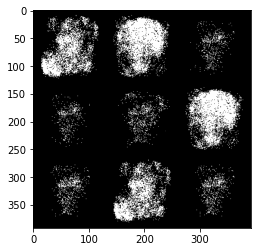

Starting epoch 242...
g_loss: 100.0, d_loss: 0.0


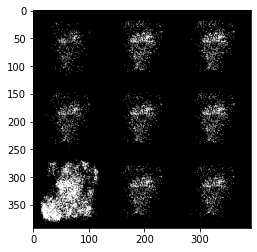

Starting epoch 243...
g_loss: 100.0, d_loss: 0.0


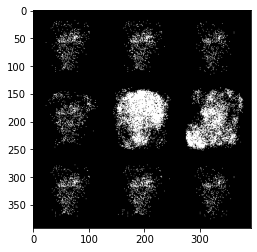

Starting epoch 244...
g_loss: 100.0, d_loss: 0.0


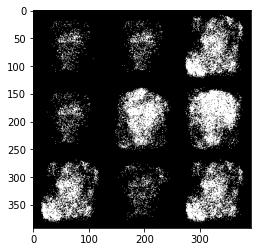

Starting epoch 245...
g_loss: 100.0, d_loss: 0.0


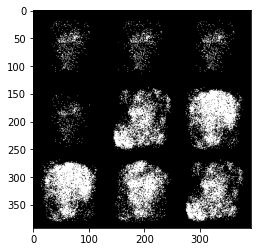

Starting epoch 246...
g_loss: 100.0, d_loss: 0.0


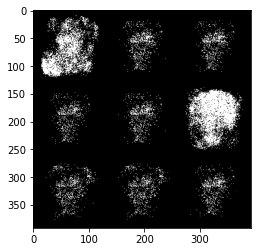

Starting epoch 247...
g_loss: 100.0, d_loss: 0.0


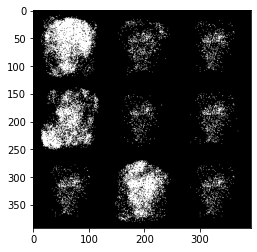

Starting epoch 248...
g_loss: 100.0, d_loss: 0.0


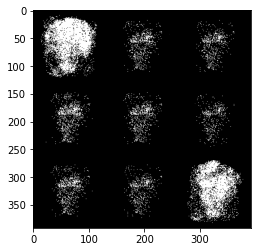

Starting epoch 249...
g_loss: 100.0, d_loss: 0.0


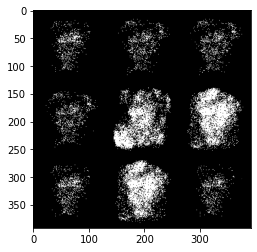

Starting epoch 250...
g_loss: 100.0, d_loss: 0.0


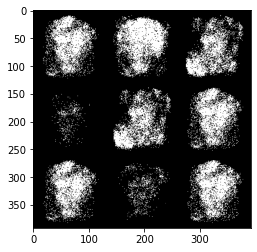

Starting epoch 251...
g_loss: 100.0, d_loss: 0.0


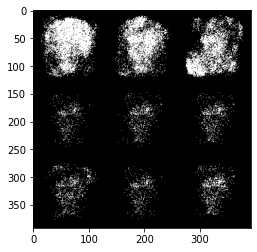

Starting epoch 252...
g_loss: 100.0, d_loss: 0.0


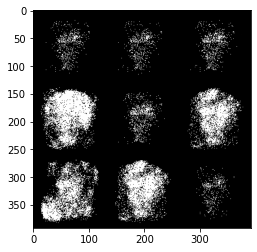

Starting epoch 253...
g_loss: 100.0, d_loss: 0.0


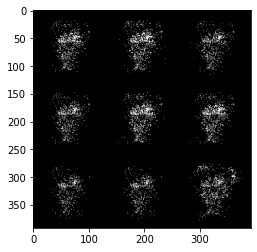

Starting epoch 254...
g_loss: 100.0, d_loss: 0.0


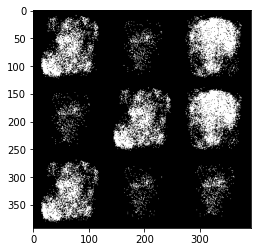

Starting epoch 255...
g_loss: 100.0, d_loss: 0.0


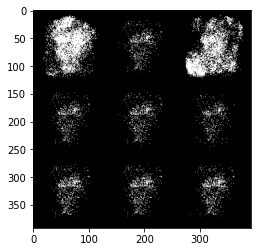

Starting epoch 256...
g_loss: 100.0, d_loss: 0.0


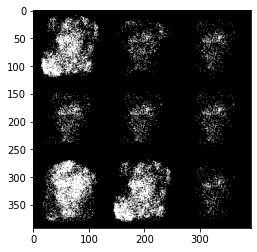

Starting epoch 257...
g_loss: 100.0, d_loss: 0.0


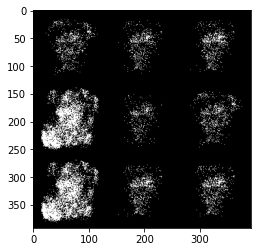

Starting epoch 258...
g_loss: 100.0, d_loss: 0.0


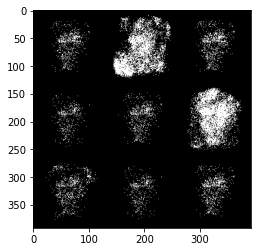

Starting epoch 259...
g_loss: 100.0, d_loss: 0.0


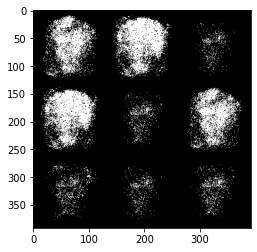

Starting epoch 260...
g_loss: 100.0, d_loss: 0.0


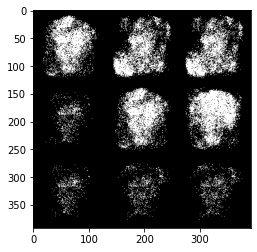

Starting epoch 261...
g_loss: 100.0, d_loss: 0.0


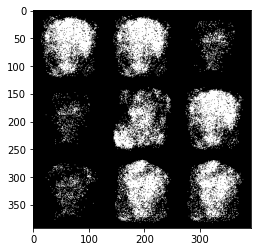

Starting epoch 262...
g_loss: 100.0, d_loss: 0.0


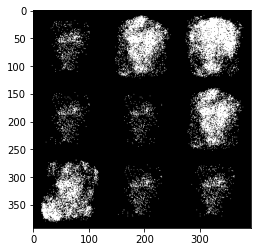

Starting epoch 263...
g_loss: 100.0, d_loss: 0.0


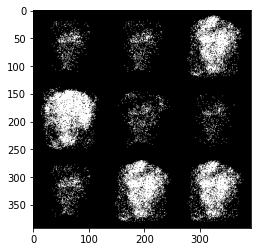

Starting epoch 264...
g_loss: 100.0, d_loss: 0.0


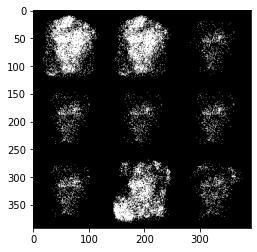

Starting epoch 265...
g_loss: 100.0, d_loss: 0.0


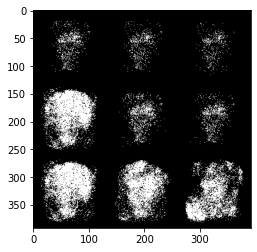

Starting epoch 266...
g_loss: 100.0, d_loss: 0.0


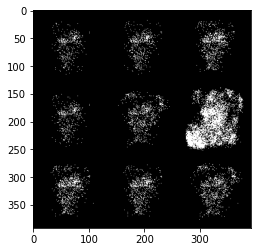

Starting epoch 267...
g_loss: 100.0, d_loss: 0.0


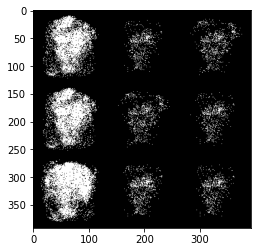

Starting epoch 268...
g_loss: 100.0, d_loss: 0.0


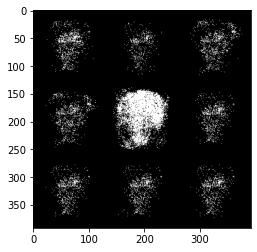

Starting epoch 269...
g_loss: 100.0, d_loss: 0.0


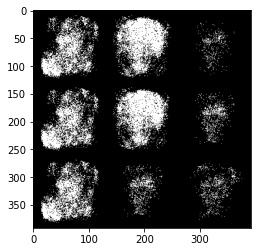

Starting epoch 270...
g_loss: 100.0, d_loss: 0.0


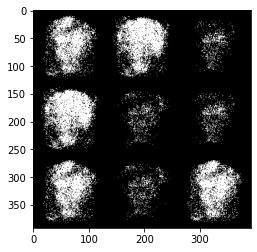

Starting epoch 271...
g_loss: 100.0, d_loss: 0.0


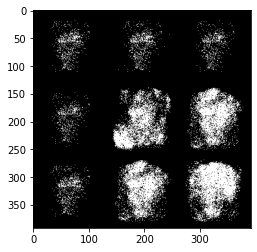

Starting epoch 272...
g_loss: 100.0, d_loss: 0.0


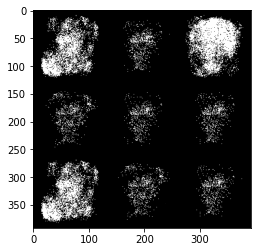

Starting epoch 273...
g_loss: 100.0, d_loss: 0.0


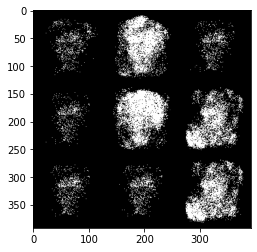

Starting epoch 274...
g_loss: 100.0, d_loss: 0.0


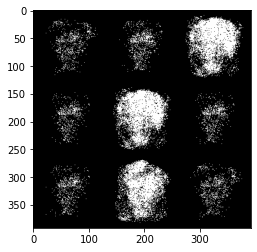

Starting epoch 275...
g_loss: 100.0, d_loss: 0.0


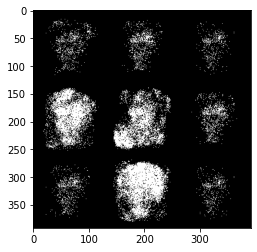

Starting epoch 276...
g_loss: 100.0, d_loss: 0.0


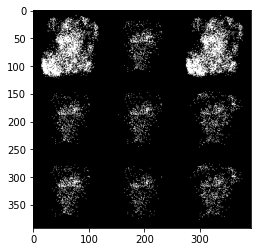

Starting epoch 277...
g_loss: 100.0, d_loss: 0.0


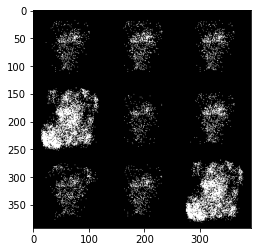

Starting epoch 278...
g_loss: 100.0, d_loss: 0.0


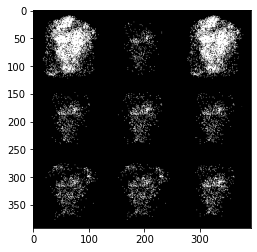

Starting epoch 279...
g_loss: 100.0, d_loss: 0.0


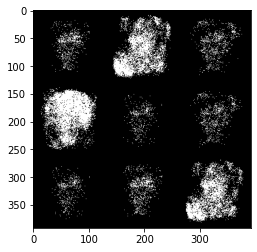

Starting epoch 280...
g_loss: 100.0, d_loss: 0.0


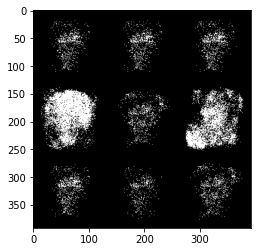

Starting epoch 281...
g_loss: 100.0, d_loss: 0.0


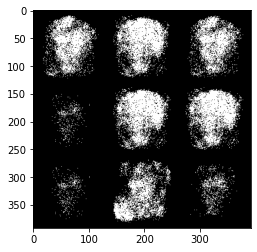

Starting epoch 282...
g_loss: 100.0, d_loss: 0.0


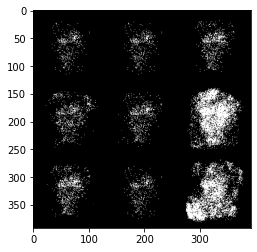

Starting epoch 283...
g_loss: 100.0, d_loss: 0.0


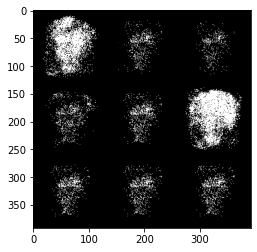

Starting epoch 284...
g_loss: 100.0, d_loss: 0.0


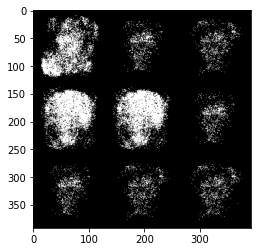

Starting epoch 285...
g_loss: 100.0, d_loss: 0.0


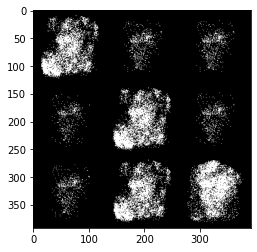

Starting epoch 286...
g_loss: 100.0, d_loss: 0.0


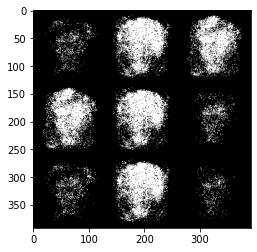

Starting epoch 287...
g_loss: 100.0, d_loss: 0.0


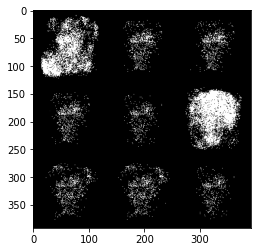

Starting epoch 288...
g_loss: 100.0, d_loss: 0.0


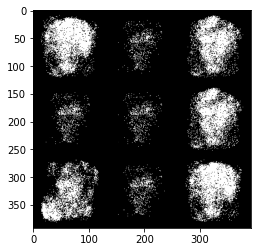

Starting epoch 289...
g_loss: 100.0, d_loss: 0.0


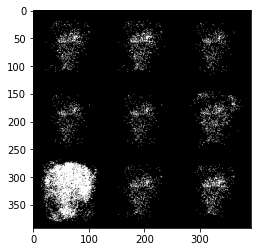

Starting epoch 290...
g_loss: 100.0, d_loss: 0.0


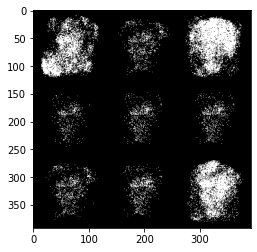

Starting epoch 291...
g_loss: 100.0, d_loss: 0.0


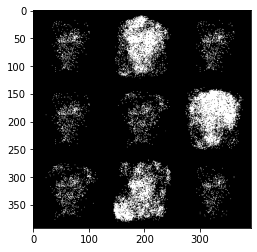

Starting epoch 292...
g_loss: 100.0, d_loss: 0.0


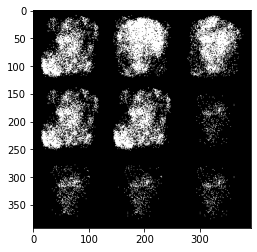

Starting epoch 293...
g_loss: 100.0, d_loss: 0.0


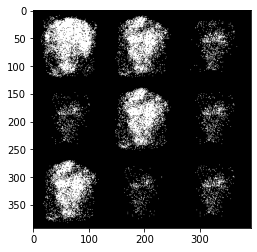

Starting epoch 294...
g_loss: 100.0, d_loss: 0.0


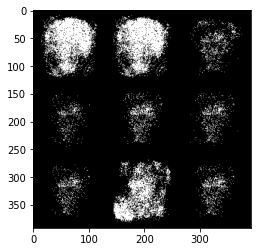

Starting epoch 295...
g_loss: 100.0, d_loss: 0.0


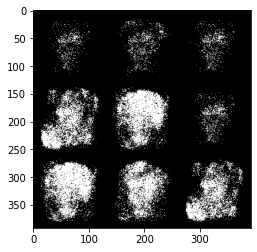

Starting epoch 296...
g_loss: 100.0, d_loss: 0.0


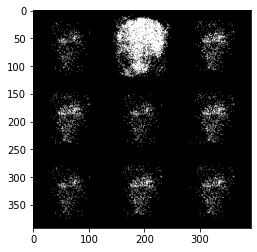

Starting epoch 297...
g_loss: 100.0, d_loss: 0.0


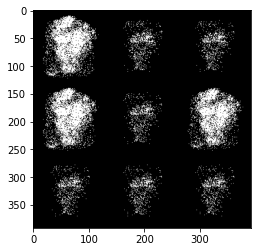

Starting epoch 298...
g_loss: 100.0, d_loss: 0.0


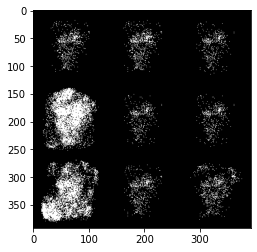

Starting epoch 299...
g_loss: 100.0, d_loss: 0.0


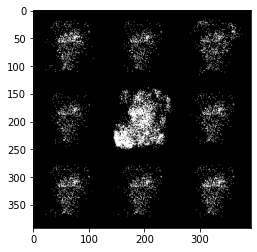

In [369]:
num_epochs = 100
n_critic = 5
display_step = 300
for epoch in range(num_epochs):
    print('Starting epoch {}...'.format(epoch))
    for i, (images, labels) in enumerate(data_loader):
        real_images = Variable(images).cuda()
        labels = Variable(labels).cuda()
        generator.train()
        batch_size = real_images.size(0)
        #print('training', labels.shape)
        d_loss = discriminator_train_step(len(real_images), discriminator,
                                          generator, d_optimizer, criterion,
                                          real_images, labels)
        

        g_loss = generator_train_step(batch_size, discriminator, generator, g_optimizer, criterion)

    generator.eval()
    print('g_loss: {}, d_loss: {}'.format(g_loss, d_loss))
    z = Variable(torch.randn(9, 100)).cuda()
    labels = torch.nn.functional.one_hot( torch.randint(0, 9, (9,)),num_classes=9).cuda()
    sample_images = generator(z, labels).unsqueeze(1).data.cpu()
    grid = make_grid(sample_images, nrow=3, normalize=True).permute(1,2,0).numpy()
    plt.imshow(grid)
    plt.show()

In [370]:
import json

def read_json(json_path):
    data = json.load(open(json_path))
    print(list(data))
    return data

In [ ]:
path = './label_images_of_brown.json'
dataj = read_json(path)

In [11]:
 len(dataj)

2

In [14]:
next(iter(dataj)) # outputs 'foo'

'id'

In [16]:
next(iter(dataj))

'id'

KeyError: 0

In [18]:
for _ in range(5):
    print(next(iter(dataj)))

id
id
id
id
id


In [20]:
next(iter(prices))

NameError: name 'prices' is not defined

In [ ]:
num_epochs = 30
n_critic = 5
display_step = 300
for epoch in range(num_epochs):
    print('Starting epoch {}...'.format(epoch))
    for i, (images, labels) in enumerate(data_loader):
        real_images = Variable(images).cuda()
        labels = Variable(labels).cuda()
        generator.train()
        batch_size = real_images.size(0)
        print('training', labels.shape)
        d_loss = discriminator_train_step(len(real_images), discriminator,
                                          generator, d_optimizer, criterion,
                                          real_images, labels)
        

        g_loss = generator_train_step(batch_size, discriminator, generator, g_optimizer, criterion)

    generator.eval()
    print('g_loss: {}, d_loss: {}'.format(g_loss, d_loss))
    z = Variable(torch.randn(9, 100)).cuda()
    labels = Variable(torch.LongTensor(np.arange(9))).cuda()
    sample_images = generator(z, labels).unsqueeze(1).data.cpu()
    grid = make_grid(sample_images, nrow=3, normalize=True).permute(1,2,0).numpy()
    plt.imshow(grid)
    plt.show()